<p style="font-family:newtimeroman;font-size:200%;color:white;text-align:center;border-radius:20px 20px;"><b>EDA Project - Earthquake Data</b></p>


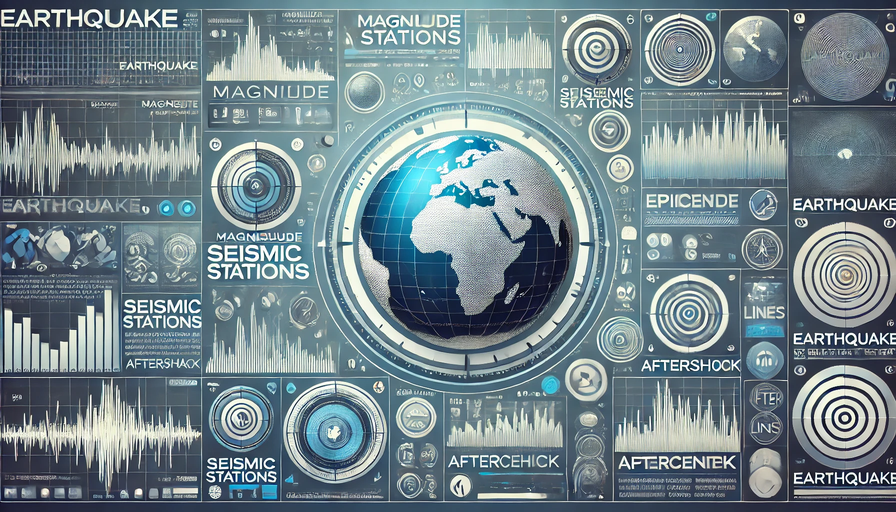


<b>Contains:</b>
<ul>
<li><a href="#import-library">Importing Libraries</a></li>
<li><a href="#understanding-dataset">Understanding The Dataset</a></li>
<li><a href="#data-visualization">Data Visualization</a></li>
<li><a href="#conclusion">Conclusion</a></li>
</ul>

<a id='import-library'></a>
# <b>Importing Libraries</b><font color='black'> 

In [2]:
# Importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from scipy.stats import skew, kurtosis, shapiro
# Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")


pd.set_option('display.max_rows', 20)   # Set the maximum number of rows displayed
pd.set_option('display.max_columns', 20) # Set the maximum number of columns displayed


In [3]:
# Load earthquake data from a CSV file into a DataFrame
df = pd.read_csv("earthquakes_dataset.csv")
df

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.2460,145.6160,Earthquake,131.60,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.8630,127.3520,Earthquake,80.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.5790,-173.9720,Earthquake,20.00,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.0760,-23.5570,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.9380,126.4270,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,12/28/2016,08:22:12,38.3917,-118.8941,Earthquake,12.30,1.2,40.0,5.6,ML,...,18.0,42.47,0.120,NaN,0.1898,NN00570710,NN,NN,NN,Reviewed
23408,12/28/2016,09:13:47,38.3777,-118.8957,Earthquake,8.80,2.0,33.0,5.5,ML,...,18.0,48.58,0.129,NaN,0.2187,NN00570744,NN,NN,NN,Reviewed
23409,12/28/2016,12:38:51,36.9179,140.4262,Earthquake,10.00,1.8,NaN,5.9,MWW,...,NaN,91.00,0.992,4.8,1.5200,US10007NAF,US,US,US,Reviewed
23410,12/29/2016,22:30:19,-9.0283,118.6639,Earthquake,79.00,1.8,NaN,6.3,MWW,...,NaN,26.00,3.553,6.0,1.4300,US10007NL0,US,US,US,Reviewed


In [4]:
# Display the first 5 rows of the DataFrame
df.head()

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


<a id='understanding-dataset'></a>
# <b>Understanding The Dataset</b><font color='black'> 

In [5]:
df.Type.unique()

array(['Earthquake', 'Nuclear Explosion', 'Explosion', 'Rock Burst'],
      dtype=object)

In [6]:
# Provides a concise summary of the DataFrame

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Date                        23412 non-null  object 
 1   Time                        23412 non-null  object 
 2   Latitude                    23412 non-null  float64
 3   Longitude                   23412 non-null  float64
 4   Type                        23412 non-null  object 
 5   Depth                       23412 non-null  float64
 6   Depth Error                 4461 non-null   float64
 7   Depth Seismic Stations      7097 non-null   float64
 8   Magnitude                   23412 non-null  float64
 9   Magnitude Type              23409 non-null  object 
 10  Magnitude Error             327 non-null    float64
 11  Magnitude Seismic Stations  2564 non-null   float64
 12  Azimuthal Gap               7299 non-null   float64
 13  Horizontal Distance         160

In [7]:
# Display the number of rows and columns.

In [8]:
# Generates descriptive statistics of numerical columns and transposes the result
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Latitude,23412.0,1.679033,30.113183,-77.080000,-18.65300,-3.5685,26.19075,86.005
Longitude,23412.0,39.639961,125.511959,-179.997000,-76.34975,103.9820,145.02625,179.998
Depth,23412.0,70.767911,122.651898,-1.100000,14.52250,33.0000,54.00000,700.000
Depth Error,4461.0,4.993115,4.875184,0.000000,1.80000,3.5000,6.30000,91.295
Depth Seismic Stations,7097.0,275.364098,162.141631,0.000000,146.00000,255.0000,384.00000,934.000
Magnitude,23412.0,5.882531,0.423066,5.500000,5.60000,5.7000,6.00000,9.100
Magnitude Error,327.0,0.071820,0.051466,0.000000,0.04600,0.0590,0.07550,0.410
Magnitude Seismic Stations,2564.0,48.944618,62.943106,0.000000,10.00000,28.0000,66.00000,821.000
Azimuthal Gap,7299.0,44.163532,32.141486,0.000000,24.10000,36.0000,54.00000,360.000
Horizontal Distance,1604.0,3.992660,5.377262,0.004505,0.96875,2.3195,4.72450,37.874


In [9]:
# Generate a quick summary of the dataset, providing an overview of each column
from skimpy import skim
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 23412  │ │ float64     │ 12    │                                                          │
│ │ Number of columns │ 21     │ │ string      │ 9     │                                                          │
│ └───────────────────┴────────┘ └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name     ┃ NA    ┃ NA %  ┃ mean    ┃ sd      ┃ p0       ┃ p25    ┃ p50    ┃ p75    ┃ p100  ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━┩  │
│ │ Latitude        │     0 │     0 │   1.679 │   30.11 │   -77.08 │ -18.65 │ -3.569 │  26.19 │    86 │ ▁▂▇▃▅  │  │
│ │ Longitude       │     0 │     0 │   39.64 │   125.5 │     -180 │ -76.35 │    104 │    145 │   180 │ ▃▃▁▁▂▇ │  │
│ │ Depth           │     0 │     0 │   70.77 │   122.7 │     -1.1 │  14.52 │     33 │     54 │   700 │   ▇▁   │  │
│ │ Depth Error     │ 18951 │ 80.95 │   4.993 │   4.875 │        0 │    1.8 │    3.5 │    6.3 │  91.3 │   ▇    │  │
│ │ Depth Seismic   │ 16315 │ 69.69 │   275.4 │   162.1 │        0 │    146 │    255 │    384 │   934 │ ▆▇▆▂▁  │  │
│ │ Stations        │       │       │         │         │          │        │        │        │       │        │  │
│ │ Magnitude       │     0 │     0 │   5.883 │  0.4231 │      5.5 │    5.6 │    5.7 │      6 │   9.1 │  ▇▂▁   │  │
│ │ Magnitude Error │ 23085 │  98.6 │ 0.07182 │ 0.05147 │        0 │  0.046 │  0.059 │ 0.0755 │  0.41 │   ▇▃   │  │
│ │ Magnitude       │ 20848 │ 89.05 │   48.94 │   62.94 │        0 │     10 │     28 │     66 │   821 │   ▇▁   │  │
│ │ Seismic         │       │       │         │         │          │        │        │        │       │        │  │
│ │ Stations        │       │       │         │         │          │        │        │        │       │        │  │
│ │ Azimuthal Gap   │ 16113 │ 68.82 │   44.16 │   32.14 │        0 │   24.1 │     36 │     54 │   360 │   ▇▂   │  │
│ │ Horizontal      │ 21808 │ 93.15 │   3.993 │   5.377 │ 0.004505 │ 0.9688 │  2.319 │  4.724 │ 37.87 │   ▇▁   │  │
│ │ Distance        │       │       │         │         │          │        │        │        │       │        │  │
│ │ Horizontal      │ 22256 │ 95.06 │   7.663 │   10.43 │    0.085 │    5.3 │    6.7 │    8.1 │    99 │   ▇    │  │
│ │ Error           │       │       │         │         │          │        │        │        │       │        │  │
│ │ Root Mean       │  6060 │ 25.88 │   1.023 │  0.1885 │        0 │    0.9 │      1 │   1.13 │  3.44 │   ▇▂   │  │
│ │ Square          │       │       │         │         │          │        │        │        │       │        │  │
│ └─────────────────┴───────┴───────┴─────────┴─────────┴──────────┴────────┴────────┴────────┴───────┴────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                      ┃ NA     ┃ NA %      ┃ words per row              ┃ total words           ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━

In [10]:
df.columns

Index(['Date', 'Time', 'Latitude', 'Longitude', 'Type', 'Depth', 'Depth Error',
       'Depth Seismic Stations', 'Magnitude', 'Magnitude Type',
       'Magnitude Error', 'Magnitude Seismic Stations', 'Azimuthal Gap',
       'Horizontal Distance', 'Horizontal Error', 'Root Mean Square', 'ID',
       'Source', 'Location Source', 'Magnitude Source', 'Status'],
      dtype='object')

In [11]:
df.columns = df.columns.str.replace(" ", "_")

In [12]:
df.columns

Index(['Date', 'Time', 'Latitude', 'Longitude', 'Type', 'Depth', 'Depth_Error',
       'Depth_Seismic_Stations', 'Magnitude', 'Magnitude_Type',
       'Magnitude_Error', 'Magnitude_Seismic_Stations', 'Azimuthal_Gap',
       'Horizontal_Distance', 'Horizontal_Error', 'Root_Mean_Square', 'ID',
       'Source', 'Location_Source', 'Magnitude_Source', 'Status'],
      dtype='object')

In [13]:
# Display the number of rows and columns.
df.shape

(23412, 21)

In [14]:
df.dtypes

Date                 object
Time                 object
Latitude            float64
Longitude           float64
Type                 object
                     ...   
ID                   object
Source               object
Location_Source      object
Magnitude_Source     object
Status               object
Length: 21, dtype: object

In [15]:

df.count()

Date                23412
Time                23412
Latitude            23412
Longitude           23412
Type                23412
                    ...  
ID                  23412
Source              23412
Location_Source     23412
Magnitude_Source    23412
Status              23412
Length: 21, dtype: int64

In [16]:
# Counts the number of duplicate rows in the DataFrame.
df.duplicated()


0        False
1        False
2        False
3        False
4        False
         ...  
23407    False
23408    False
23409    False
23410    False
23411    False
Length: 23412, dtype: bool

In [17]:
df.duplicated().sum()

np.int64(0)

In [18]:
# Missing (NaN) Values
df.isnull()

,Date,Time,Latitude,Longitude,Type,Depth,Depth_Error,Depth_Seismic_Stations,Magnitude,Magnitude_Type,...,Magnitude_Seismic_Stations,Azimuthal_Gap,Horizontal_Distance,Horizontal_Error,Root_Mean_Square,ID,Source,Location_Source,Magnitude_Source,Status
0,False,False,False,False,False,False,True,True,False,False,...,True,True,True,True,True,False,False,False,False,False
1,False,False,False,False,False,False,True,True,False,False,...,True,True,True,True,True,False,False,False,False,False
2,False,False,False,False,False,False,True,True,False,False,...,True,True,True,True,True,False,False,False,False,False
3,False,False,False,False,False,False,True,True,False,False,...,True,True,True,True,True,False,False,False,False,False
4,False,False,False,False,False,False,True,True,False,False,...,True,True,True,True,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
23408,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
23409,False,False,False,False,False,False,False,True,False,False,...,True,False,False,False,False,False,False,False,False,False
23410,False,False,False,False,False,False,False,True,False,False,...,True,False,False,False,False,False,False,False,False,False


In [19]:
# Number of missing (null) values for each column.
df.isnull().sum()

Date                0
Time                0
Latitude            0
Longitude           0
Type                0
                   ..
ID                  0
Source              0
Location_Source     0
Magnitude_Source    0
Status              0
Length: 21, dtype: int64

In [20]:
# List of columns to drop
columns_to_drop = ['Magnitude_Error', 'Magnitude_Seismic_Stations','Horizontal_Distance', 'Horizontal_Error']


In [21]:
# Dropping the columns
df.drop(columns=columns_to_drop, axis=1, inplace= True)


<Axes: >

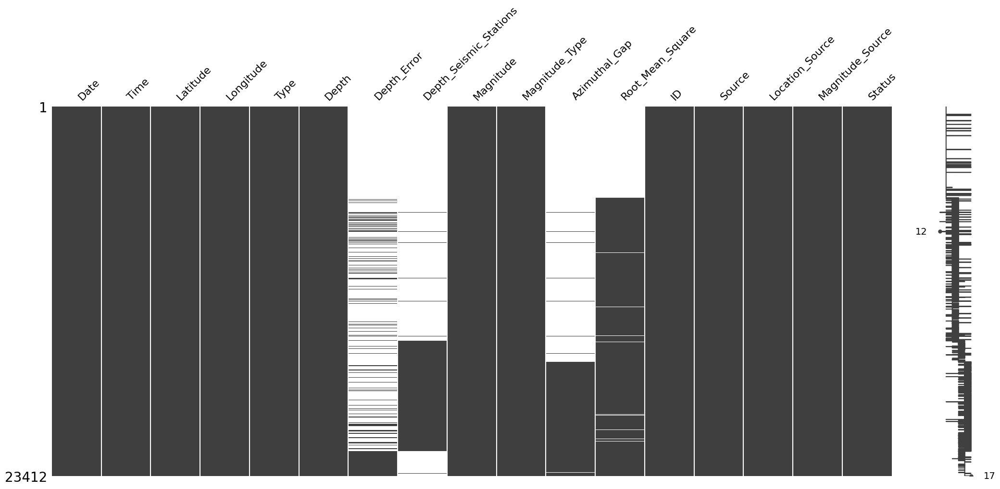

In [22]:
# Visualizes the missing values in the DataFrame using a missing value matrix from the missingno library.
msno.matrix(df)

## Handling the Missing Values

In [23]:
df.Depth_Error

0        NaN
1        NaN
2        NaN
3        NaN
4        NaN
        ... 
23407    1.2
23408    2.0
23409    1.8
23410    1.8
23411    2.2
Name: Depth_Error, Length: 23412, dtype: float64

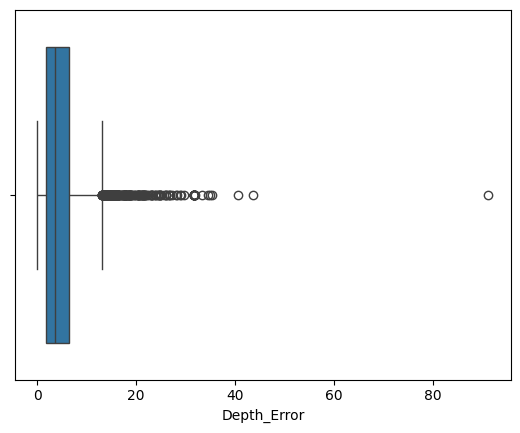

In [24]:
# Plotting data to visualize distributions 
sns.boxplot(x=df.Depth_Error);
# It doesn't normally distrubited, so missing values should be fill in with median.

In [25]:
df.Depth_Error.median()

np.float64(3.5)

In [26]:
DE_median = df.Depth_Error.median()

In [27]:
df.Depth_Error.fillna(DE_median, inplace=True)

In [28]:
df.Depth_Seismic_Stations

0         NaN
1         NaN
2         NaN
3         NaN
4         NaN
         ... 
23407    40.0
23408    33.0
23409     NaN
23410     NaN
23411     NaN
Name: Depth_Seismic_Stations, Length: 23412, dtype: float64

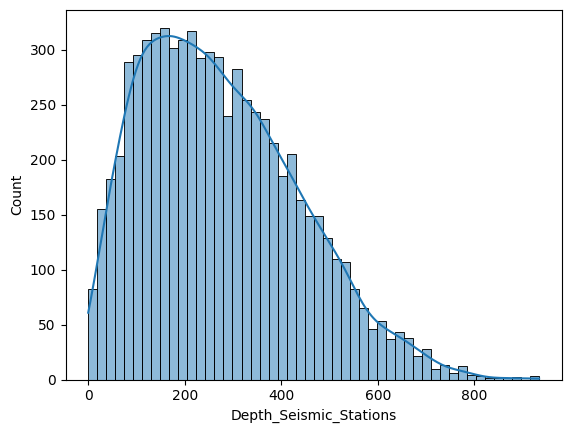

In [29]:
# Plotting data to visualize distributions
sns.histplot(df.Depth_Seismic_Stations, kde=True, bins=50);

In [30]:
Dss_median = df.Depth_Seismic_Stations.median()
df.Depth_Seismic_Stations.fillna(Dss_median, inplace=True)

In [31]:
df.Azimuthal_Gap.median()

np.float64(36.0)

In [32]:
AG_median = df.Azimuthal_Gap.median()
df.Azimuthal_Gap.fillna(AG_median, inplace=True)


In [33]:
df.Root_Mean_Square.median()

np.float64(1.0)

In [34]:
RMS_median = df.Root_Mean_Square.median()
df.Root_Mean_Square.fillna(RMS_median, inplace=True)

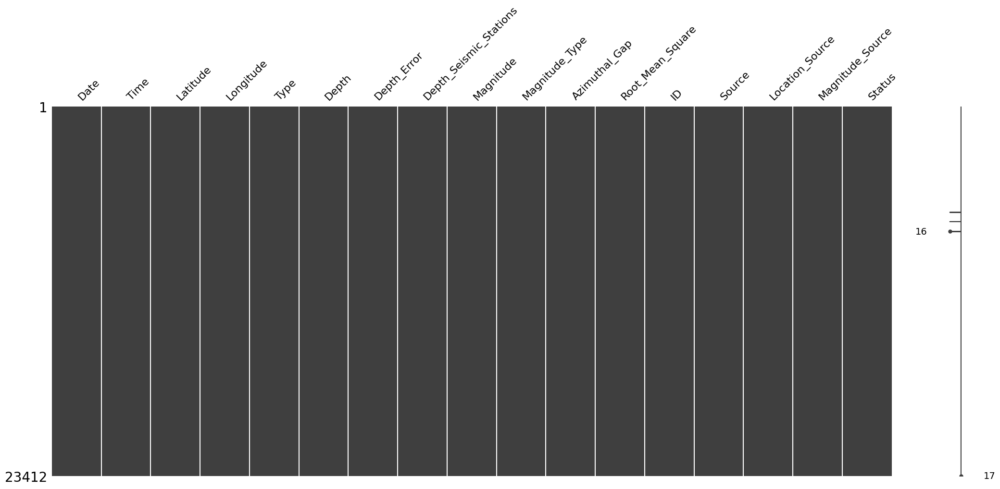

In [35]:
# Missing (NaN) Values in missigno library
msno.matrix(df);

In [36]:
# Root Mean Square (RMS) Analysis
# Categorize RMS values
df['RMS_Stability'] = pd.cut(df['Root_Mean_Square'], bins=[0, 1, 2, np.inf], labels=['Low', 'Moderate', 'High'])


In [37]:
df.RMS_Stability

0             Low
1             Low
2             Low
3             Low
4             Low
           ...   
23407         Low
23408         Low
23409    Moderate
23410    Moderate
23411         Low
Name: RMS_Stability, Length: 23412, dtype: category
Categories (3, object): ['Low' < 'Moderate' < 'High']

In [54]:
type_counts = df['Type'].value_counts()
type_counts

Type
Earthquake           23232
Nuclear Explosion      175
Explosion                4
Rock Burst               1
Name: count, dtype: int64


<a id='visulation of Dataset'></a>
# <b>Visulation of Dataset</b><font color='black'> 

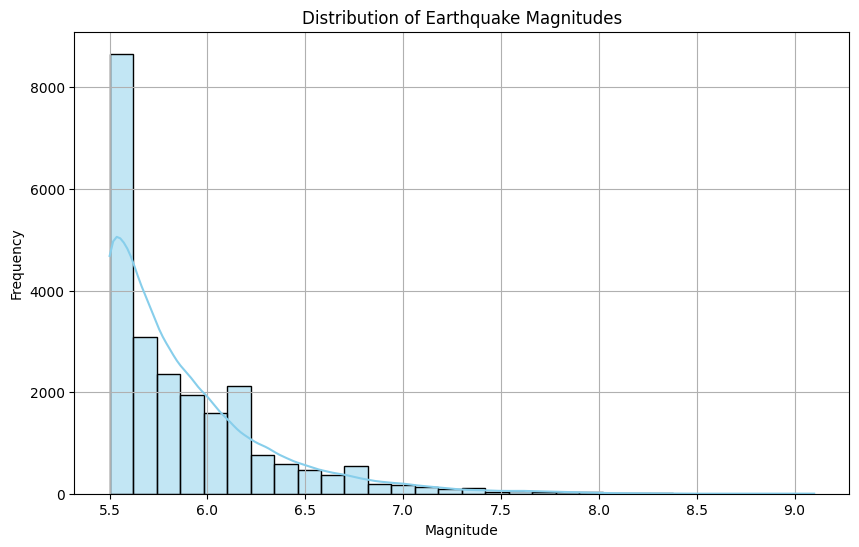

In [40]:
# Set up the plot
plt.figure(figsize=(10, 6))

# Plotting the distribution
sns.histplot(df['Magnitude'], bins=30, kde=True, color='skyblue')

# Customize the plot
plt.title('Distribution of Earthquake Magnitudes')
plt.xlabel('Magnitude')
plt.ylabel('Frequency')
plt.grid(True)

# Show the plot
plt.show()


The histogram visualizes the distribution of earthquake magnitudes. The majority of earthquakes fall within the lower magnitude range (5.5-6.0), with frequencies sharply decreasing as magnitudes increase. This suggests that lower-magnitude earthquakes are more common, while higher-magnitude earthquakes are rare. The line overlay indicates a density estimate, which helps illustrate the trend of frequency decline with increasing magnitude.

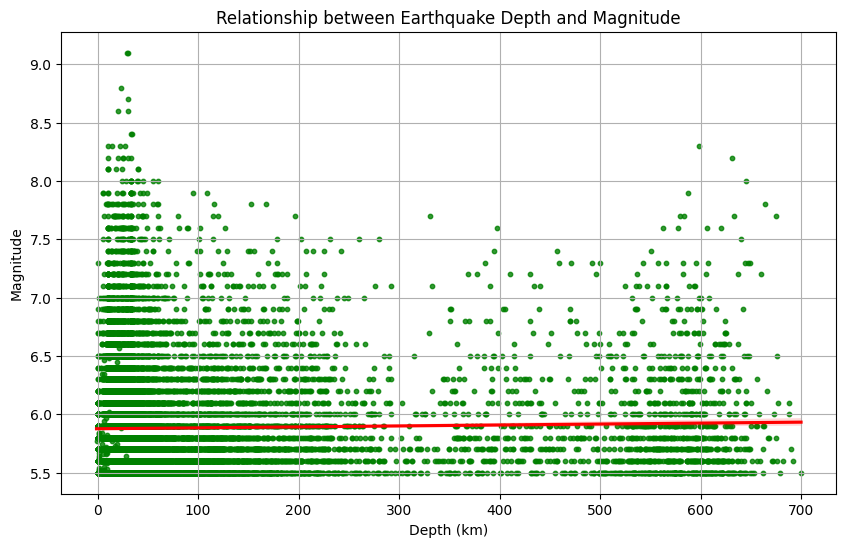

In [41]:
# Set up the plot
plt.figure(figsize=(10, 6))

# Scatter plot with regression line
sns.regplot(x='Depth', y='Magnitude', data=df, scatter_kws={'s': 10, 'color': 'green'}, line_kws={'color': 'red'})

# Customize the plot
plt.title('Relationship between Earthquake Depth and Magnitude')
plt.xlabel('Depth (km)')
plt.ylabel('Magnitude')
plt.grid(True)

# Show the plot
plt.show()


The relationship between earthquake depth and magnitude. Each green dot represents an individual earthquake. The red line likely represents a reference threshold for earthquake magnitudes. The plot suggests that earthquakes of various magnitudes can occur at different depths, with no strong correlation between depth and magnitude observed here. Most earthquakes have magnitudes between 5.5 and 7.0, regardless of their depth.


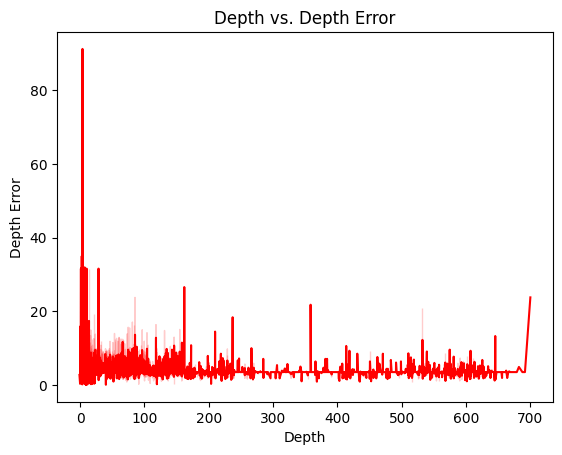

In [42]:
# Custom palette
custom_palette = sns.color_palette("coolwarm", 8) 

# Applying the custom palette
sns.lineplot(x='Depth', y='Depth_Error', data=df, color='red')
plt.title('Depth vs. Depth Error')
plt.xlabel('Depth')
plt.ylabel('Depth Error')
plt.show()


The relationship between earthquake depth and depth error. The high depth error values at shallow depths (near 0) indicate greater measurement uncertainty at lower depths. As the depth increases, the depth error generally decreases, with occasional spikes. This suggests that depth measurements become more stable with increasing depth, but there are some outliers where errors are still significant.

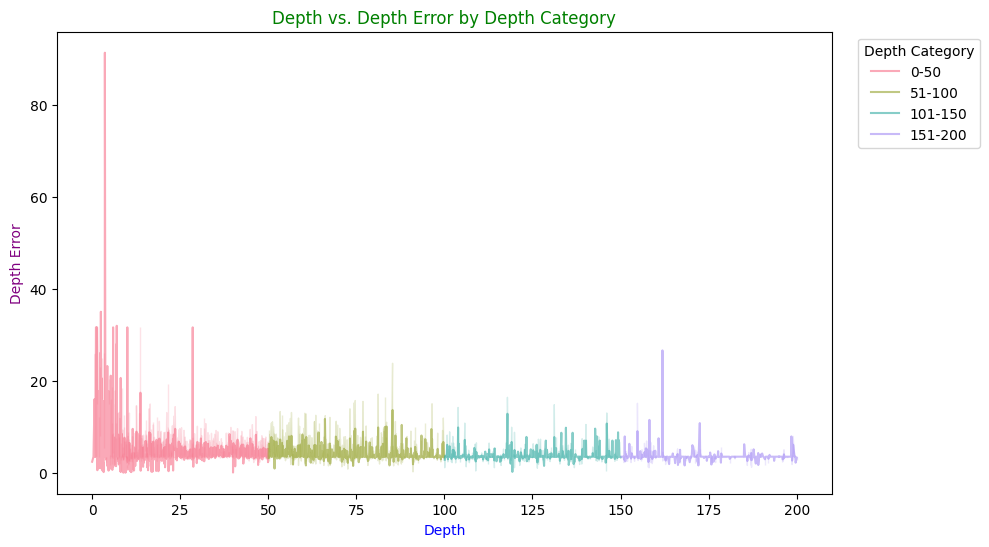

In [61]:
# Create a new feature for categorizing depth into bins
df['Depth_Category'] =pd.cut(df['Depth'], bins=[0, 50, 100, 150, 200], labels=['0-50', '51-100', '101-150', '151-200'])

plt.figure(figsize=(10, 6))
# Plot with hue based on new depth categories
sns.lineplot(x='Depth', y='Depth_Error', hue='Depth_Category', data=df, palette='husl', alpha=0.6)
plt.title('Depth vs. Depth Error by Depth Category', color = 'green')
plt.xlabel('Depth', color = 'blue')
plt.ylabel('Depth Error', color = 'purple')
# Position legend outside
plt.legend(title="Depth Category", loc="upper right", bbox_to_anchor=(1.2, 1)) 
plt.show()





This line plot illustrates the relationship between earthquake depth and depth error, segmented by depth categories (0–50, 51–100, 101–150, and 151–200). Each color represents a different depth range, showing how measurement errors vary across these categories. This pattern suggests that measurement accuracy improves with depth, but minor fluctuations are present in each range. The color-coding effectively highlights the distribution of errors across the different depth categories.

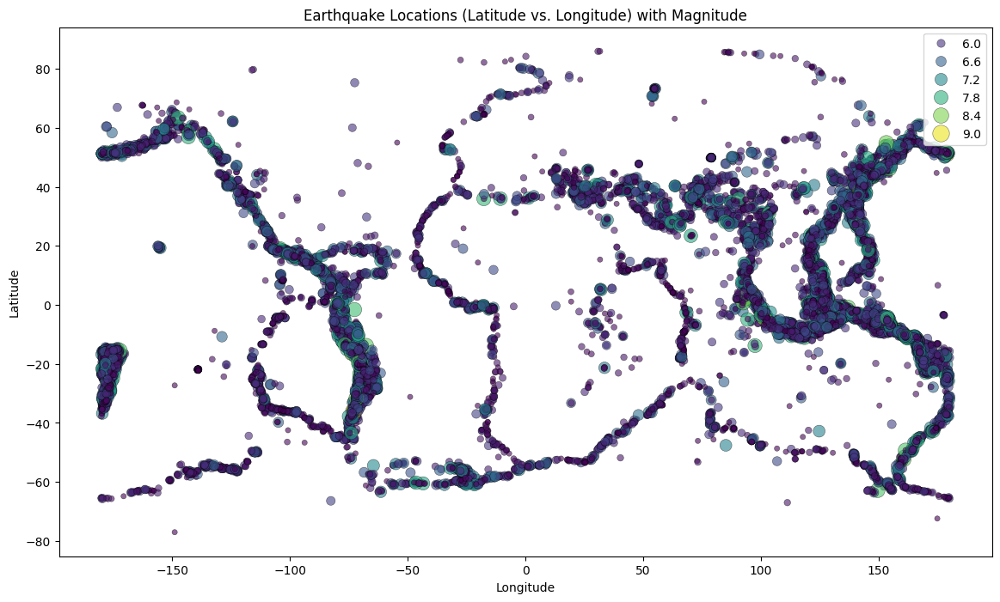

In [44]:
# Geographical Analysis
# Scatter plot of Latitude vs. Longitude with color and size representing magnitude
plt.figure(figsize=(14, 8))
sns.scatterplot(
    x='Longitude', 
    y='Latitude', 
    size='Magnitude', 
    hue='Magnitude', 
    sizes=(20, 200), 
    palette='viridis', 
    data=df, 
    alpha=0.6, 
    edgecolor='k'
)
plt.title('Earthquake Locations (Latitude vs. Longitude) with Magnitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='upper right')
plt.show()


Scatter plot shows earthquake locations worldwide. Each point represents an earthquake, with its color and size corresponding to the earthquake's magnitude. Higher magnitudes are displayed in lighter colors and larger sizes, while smaller earthquakes appear darker and smaller. The plot reveals the concentration of seismic activity along tectonic plate boundaries, particularly around the Pacific Ring of Fire, where many earthquakes occur. This visual highlights the global distribution of earthquakes and emphasizes regions of higher seismic risk.

In [45]:
#pip install folium

In [46]:
# Geographical Analysis

import folium

# Create a map centered around a global location
m = folium.Map(location=[0, 0], zoom_start=2)

# Loop through the dataset and add a marker for each earthquake
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],  # Set location using Latitude and Longitude
        radius=row['Magnitude'] * 2,  # Scale the radius by the magnitude
        color='red',
        fill=True,
        fill_color='coolwarm',
        fill_opacity=0.6,
        popup=f"Magnitude: {row['Magnitude']}, Depth: {row['Depth']} km"  # Show info on click
    ).add_to(m)

# Display the map
m

This map visualizes earthquake occurrences worldwide, with each red circle representing an earthquake's location. The dense clustering of circles, particularly around tectonic plate boundaries, indicates regions with high seismic activity. The red circles with black centers make individual earthquake locations more distinct, though the overlap in highly active areas obscures specific points. This map highlights regions prone to frequent earthquakes, such as the Pacific Ring of Fire, where tectonic plates meet, leading to higher earthquake frequency and intensity.

In [47]:
# Convert the 'Date' column to datetime format


df['Date'] = pd.to_datetime((df['Date'].astype(str)) + ' ' + df['Time'].astype(str), errors='coerce')

# Create new columns for Year, Month, and Day
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day



In [48]:
df.Date.dtypes

dtype('<M8[ns]')

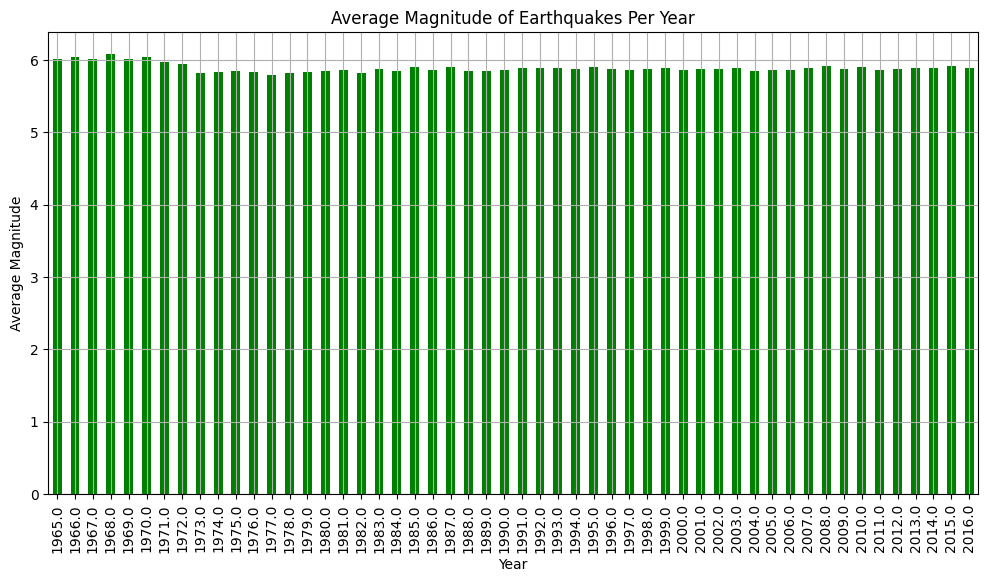

In [49]:
#Temporal Analysis

df['Year'] = pd.to_datetime(df['Date']).dt.year
yearly_magnitude = df.groupby('Year')['Magnitude'].mean()
yearly_magnitude.plot(kind='bar', figsize=(12, 6), grid=True, color= 'green' )
plt.title('Average Magnitude of Earthquakes Per Year')
plt.ylabel('Average Magnitude')
plt.show()



In [50]:
df.sample(10)


,Date,Time,Latitude,Longitude,Type,Depth,Depth_Error,Depth_Seismic_Stations,Magnitude,Magnitude_Type,...,ID,Source,Location_Source,Magnitude_Source,Status,RMS_Stability,Depth_Category,Year,Month,Day
16863,2004-07-28 04:02:00,04:02:00,-0.3280,133.0610,Earthquake,10.0,3.5,86.0,5.5,MB,...,USP000D0ZP,US,US,US,Reviewed,Low,0-50,2004.0,7.0,28.0
11143,1992-10-12 13:09:56,13:09:56,29.7780,31.1440,Earthquake,21.5,3.5,255.0,5.8,MW,...,USP0005F89,US,US,HRV,Reviewed,Moderate,0-50,1992.0,10.0,12.0
11954,1994-06-05 05:56:45,05:56:45,-10.7170,113.4920,Earthquake,33.0,3.5,255.0,5.6,MB,...,USP0006DRU,US,US,US,Reviewed,Moderate,0-50,1994.0,6.0,5.0
15563,2001-09-30 19:01:19,19:01:19,-18.4190,168.1210,Earthquake,33.0,3.5,260.0,6.2,MWC,...,USP000AQ1X,US,US,HRV,Reviewed,Moderate,0-50,2001.0,9.0,30.0
22793,2015-09-16 23:03:57,23:03:57,-31.7502,-71.7425,Earthquake,19.1,3.3,255.0,6.1,MWR,...,US20003K7M,US,US,GUC,Reviewed,Low,0-50,2015.0,9.0,16.0
9648,1989-09-30 18:19:23,18:19:23,20.2360,98.8480,Earthquake,13.1,3.5,255.0,5.8,MW,...,USP000406Y,US,US,HRV,Reviewed,Moderate,0-50,1989.0,9.0,30.0
10316,1991-01-03 13:29:19,13:29:19,-7.1710,148.4410,Earthquake,38.8,3.5,255.0,5.7,MB,...,USP0004K5H,US,US,US,Reviewed,Moderate,0-50,1991.0,1.0,3.0
15756,2002-03-15 01:20:05,01:20:05,49.6770,156.0200,Earthquake,55.0,7.3,215.0,5.5,MWC,...,USP000B0B1,US,US,HRV,Reviewed,Low,51-100,2002.0,3.0,15.0
9821,1990-01-23 07:47:10,07:47:10,-12.4510,-75.0690,Earthquake,104.2,3.5,255.0,5.6,MW,...,USP00044MM,US,US,HRV,Reviewed,Moderate,101-150,1990.0,1.0,23.0
21307,2012-06-03 11:14:48,11:14:48,-16.2350,67.2100,Earthquake,10.0,3.5,121.0,5.5,MWC,...,USP000JM95,US,US,GCMT,Reviewed,Moderate,0-50,2012.0,6.0,3.0


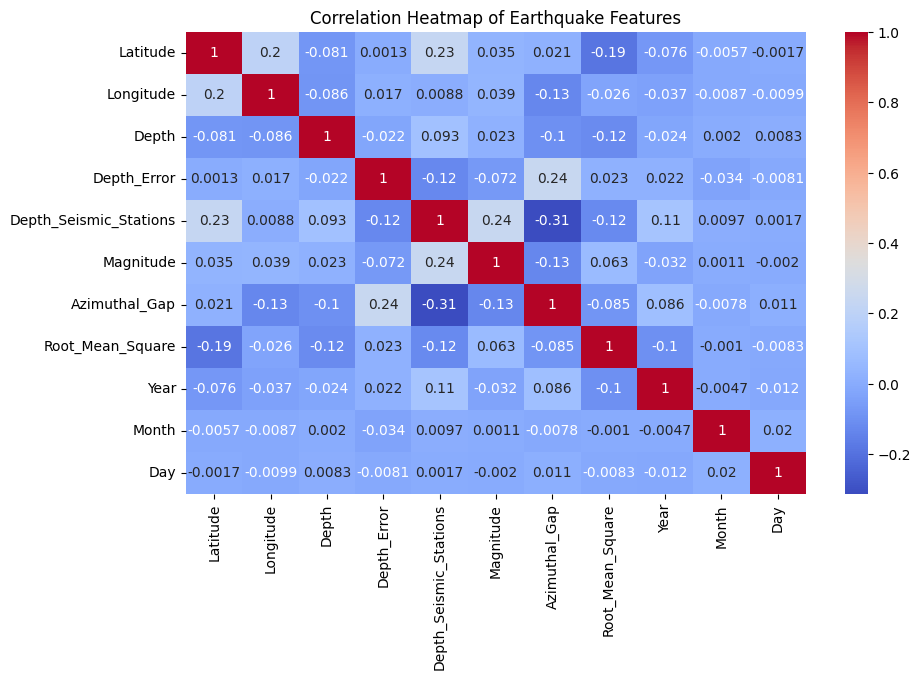

In [62]:
## Correlation Heatmap
# Select only numeric columns from the dataframe
numeric_df = df.select_dtypes(include=['number'])

# Compute the correlation matrix on numeric data
corr_matrix = numeric_df.corr()
plt.figure(figsize=(10, 6))
# Create the heatmap using the correlation matrix
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Earthquake Features')
plt.show()


This heatmap visualizes the relationships between various earthquake features, with correlation values ranging from -1 to 1. The color scale indicates the strength and direction of the correlations, with red representing positive correlations and blue representing negative correlations.

**Key observations include:**

- Latitude and Longitude show a weak positive correlation (0.2), likely due to the spatial distribution of seismic activity around tectonic boundaries.
- Depth and Depth Seismic Stations have a slight positive correlation (0.093), suggesting that deeper earthquakes may be associated with more seismic stations, though the relationship is weak.
- Azimuthal Gap and Depth Error have a moderate positive correlation (0.24), indicating that larger azimuthal gaps (the angle coverage of seismic stations) might be associated with higher depth errors.

Most other feature pairs show very weak or no correlation, indicating that these features are mostly independent.

*Overall, this heatmap reveals that the dataset's features have minimal correlations with each other, suggesting that each feature provides distinct information. This insight is valuable for modeling and analysis, as it implies a low likelihood of redundancy among features.*

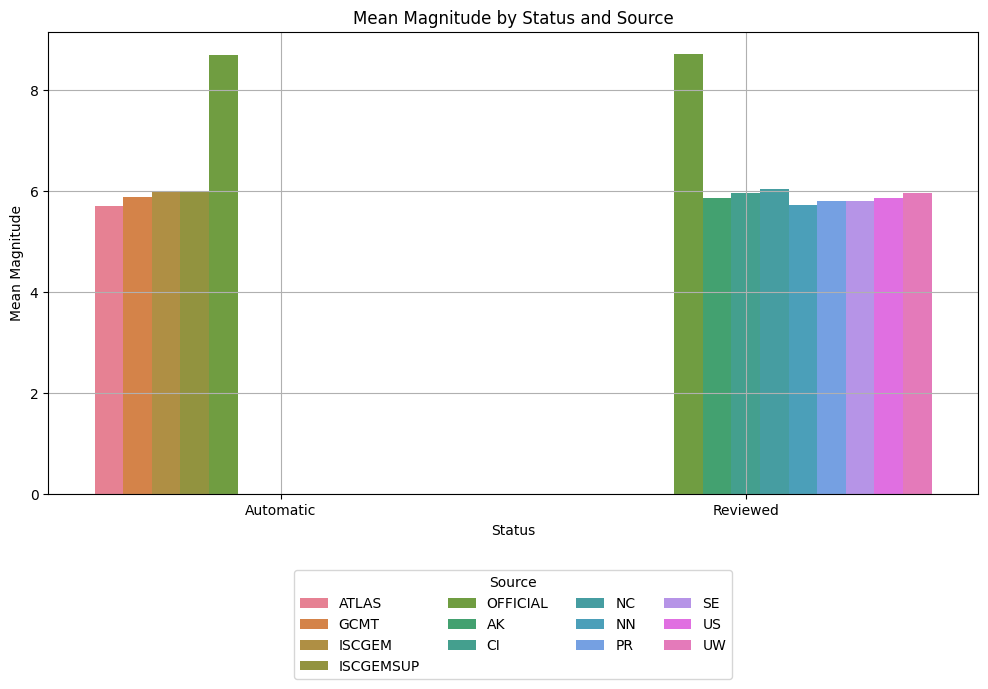

In [67]:
# Group by Status and Source and calculate mean and count
status_source_group = df.groupby(['Status', 'Source']).agg({'Magnitude': ['mean', 'std'], 'Depth': ['mean', 'std'], 'ID': 'count'}).reset_index()

# Rename columns for better readability
status_source_group.columns = ['Status', 'Source', 'Mean Magnitude', 'Magnitude Std Dev', 'Mean Depth', 'Depth Std Dev', 'Earthquake Count']

# Visualize Mean Magnitude by Status
plt.figure(figsize=(12, 6))
sns.barplot(x='Status', y='Mean Magnitude', hue='Source', data=status_source_group)
plt.title('Mean Magnitude by Status and Source')
plt.xlabel('Status')
plt.ylabel('Mean Magnitude')
plt.grid(True)
plt.legend(title='Source', loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4)
plt.show()


This bar plot compares the mean earthquake magnitude by status (Automatic vs. Reviewed) and source. Each color represents a different data source, as indicated in the legend. The "Automatic" and "Reviewed" statuses provide insight into the consistency of magnitude estimates across sources and processing types. Notably, certain sources, such as ISCGEMSUP, have higher mean magnitudes for both statuses, especially in the "Reviewed" category, which could imply a focus on significant events. The plot’s grid lines enhance readability, and the color-coded legend enables easy identification of sources.

<a id='conclusion'></a>
# <b>Conclusion</b><font color='black'> 

**Key Insights of Project:**
This project provides a comprehensive exploration of earthquake data, analyzing various aspects such as magnitude, depth, geographical distribution, and data source reliability. Through a series of visualizations, it offers insights into the frequency and severity of earthquakes globally, highlighting trends like the concentration of seismic activity along tectonic plate boundaries, the prevalence of lower-magnitude earthquakes, and the higher depth measurement errors at shallow depths.

Key findings include the identification of regions with frequent earthquakes, particularly around the Pacific Ring of Fire, and the observation that different data sources may report varying magnitudes, especially when comparing automatically and manually reviewed data. This analysis emphasizes the importance of data source reliability and review status in earthquake studies.

**This project serves as a valuable tool for understanding global seismic patterns and the quality of earthquake data from different sources. It provides essential insights for scientists, policymakers, and disaster response teams to better prepare for and mitigate the impact of seismic events. Future work could focus on integrating additional variables, such as population density or infrastructure vulnerability, to enhance risk assessment and support decision-making processes for earthquake preparedness and resilience.**